This code implements a binary segmentation model following that described in the paper: [Deciphering impedance cytometry signals with neural networks](https://pubs.rsc.org/en/content/articlelanding/2022/lc/d2lc00028h).

This version is deprecated because I have migrated to a Jupyter notebook.

## Define model

In [1]:
import torch
import torch.nn as nn

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'Device: {device}')

# Set input size
input_size = 4

class BinarySegmentationRNN(nn.Module):
    def __init__(self, input_size):
        super(BinarySegmentationRNN, self).__init__()
        self.bi_lstm = nn.LSTM(input_size=input_size, hidden_size=512, batch_first=True, bidirectional=True)
        # Output size from bi-LSTM will be 512 * 2 due to bidirectionality
        # self.batch_norm = nn.BatchNorm1d(1024)  # Batch normalization for the LSTM output
        self.fc = nn.Linear(1024, 1)  # Maps to 1 output per timestep
        self.sigmoid = nn.Sigmoid()  # Sigmoid activation to get probabilities for binary classification

    def forward(self, x):
        # x shape: (batch_size, sequence_length, 8)
        output, (hn, cn) = self.bi_lstm(x)  # output shape: (batch_size, sequence_length, 1024)

        # # Apply batch normalization
        # batch_size, seq_len, feature_size = output.size()
        # output = output.reshape(-1, feature_size)  # Reshape to (batch_size * sequence_length, 1024)
        # output = self.batch_norm(output)
        # output = output.view(batch_size, seq_len, feature_size)  # Reshape back to (batch_size, sequence_length, 1024)

        output = self.fc(output)  # (batch_size, sequence_length, 1)
        output = self.sigmoid(output)  # (batch_size, sequence_length, 1)
        return output.squeeze(-1)  # Optionally remove the last dimension for simplicity

# Example usage:
model = BinarySegmentationRNN(input_size=input_size)
# Dummy input with batch_size=10 and sequence_length=30
input_seq = torch.randn(10, 30, input_size)
output_mask = model(input_seq)
print(output_mask.shape)  # Expected shape: (10, 30), where 30 is the sequence length


Device: cuda
torch.Size([10, 30])


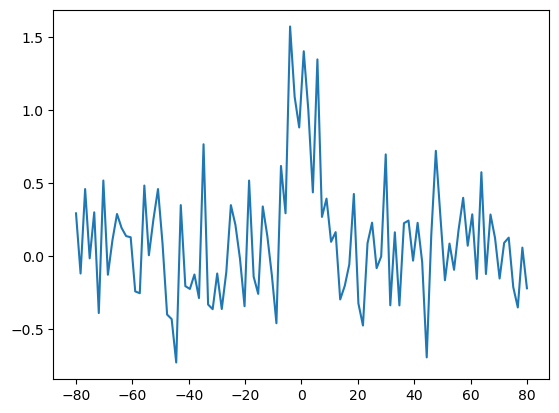

In [2]:
# Generate a gaussian curve plus noise, and plot it
# This will help us calibrate our synthetic data generator, by playing with different parameters and seeing the result
import matplotlib.pyplot as plt
import numpy as np

def gaussian(x, mu, sig):
    return np.exp(-np.power(x - mu, 2.) / (2 * np.power(sig, 2.)))

# Generate a gaussian curve
x = np.linspace(-80, 80, 100)
y = gaussian(x, 0, 6)
# Add noise
y += np.random.normal(0, 0.3, 100)

plt.plot(x, y)
plt.show()


## Generate synthetic data

In [3]:
import numpy as np

impact_range = 15 # The range within which the impact of an event is felt

#####################
# MODIFY THESE SETTINGS IN ORDER TO MAKE THE SYNTHETIC DATA MATCH THE DISTRIBUTION OF SAIFUL'S DATA
event_amplitude_means = np.array([-1.0, 3, 6, 4, 0.8, 1.3, 0.7, 0.95])  # 8-dimensional means
event_amplitude_means = event_amplitude_means[:input_size]
event_width_base = 6  # Base width for the Gaussian perturbation
noise_intensity = 0.3  # Adjust this value to see different levels of noise in the output
#####################

def generate_event_properties(n, seq_len, amplitude_means, input_size):
    """
    Generate properties for events within a sequence. This function produces three main outputs:
    event_positions, event_amplitudes, and event_widths, which are used to define the characteristics of
    events in a sequence. Essentially, this function determines when each event happens,
    and what its amplitude and width are.

    Parameters:
    n (int): The number of events to generate. This defines how many distinct events will be placed
             within the sequence.
    seq_len (int): The length of the sequence. This is the range within which events can be placed,
                   from 0 to seq_len-1.
    amplitude_means (np.array): An array of float values representing the mean of the lognormal distribution
                                for each of the 8 dimensions.

    Returns:
    tuple:
        - event_positions (list of int): A sorted list of unique integers where each integer represents
                                          the position of an event within the sequence. The positions are
                                          uniformly distributed across the sequence range.
        - event_amplitudes (list of list of float): Each sublist corresponds to an event and contains 8 float values.
                                                    These values are drawn from a lognormal distribution and represent
                                                    the amplitude of the event in each of the 8 dimensions of the sequence.
        - event_widths (list of float): A list of float values, each drawn from a lognormal distribution, representing
                                        the width (standard deviation) of the Gaussian perturbation for each event.
    """
    # Generate n unique integers within the range [0, seq_len-1]
    event_positions = np.random.choice(seq_len, size=n, replace=False)
    event_positions.sort()

    # Generate n 8-dimensional lognormal vectors with specified mean for each dimension
    lognormal_means = np.log(amplitude_means**2 / np.sqrt(1 + amplitude_means**2))
    lognormal_sds = np.sqrt(np.log(1 + 1/amplitude_means**2))
    event_amplitudes = np.exp(np.random.normal(loc=lognormal_means, scale=lognormal_sds, size=(n, input_size)))

    # Generate n sample widths from a lognormal distribution with mean event_width_base and variance 1
    variance = 1
    mu = np.log(event_width_base**2 / np.sqrt(variance + event_width_base**2))
    sigma = np.sqrt(np.log(variance / event_width_base**2 + 1))
    event_widths = np.exp(np.random.normal(loc=mu, scale=sigma, size=n))

    # Check if event_amplitudes contain nans. If so, put us in the debugger
    if np.isnan(event_amplitudes).any():
        import pdb; pdb.set_trace()

    # If any amplitude_mean is negative, set the corresponding amplitude to be negative
    for i, mean in enumerate(amplitude_means):
        if mean < 0:
            event_amplitudes[:, i] *= -1

    return event_positions.tolist(), event_amplitudes.tolist(), event_widths.tolist()

# Example usage:
n = 5
seq_len = 100
event_positions, event_amplitudes, event_widths = generate_event_properties(n, seq_len, event_amplitude_means, input_size)
print("Event positions:", event_positions)
print("Event amplitudes:", event_amplitudes)
print("Event widths:", event_widths)


Event positions: [58, 67, 81, 84, 91]
Event amplitudes: [[-0.7330984976699793, 3.988872517203412, 6.795671717969244, 3.978742792470086], [-3.1895266449710657, 2.6068986693973253, 5.387676536349836, 3.5938154669059017], [-1.569932577166426, 3.949388080181431, 4.422535677968443, 5.068195975643557], [-2.059681957048936, 1.9882088992256457, 8.531492825439315, 4.410908984911438], [-0.1907969895360883, 3.6055925907876327, 6.01322693581613, 4.456941151852732]]
Event widths: [5.794218691475411, 5.200447306268058, 6.5464824121823515, 7.248519642483223, 6.319884936945372]


In [4]:
def create_signal(seq_len, 
                  event_positions, 
                  event_amplitudes, 
                  event_widths, 
                  impact_range, 
                  noise_intensity=0.5,
                  input_size=8):
  """
  Create an 8-dimensional sequence of real numbers representing a signal perturbed by Gaussian events.
  Each event is defined by its position, amplitude, and width, affecting the sequence locally around
  its position. The perturbations decrease according to a Gaussian curve centered at each event position.

  Parameters:
  seq_len (int): The total length of the sequence to be generated.
  event_positions (list of int): The positions in the sequence where events occur. These positions are
                                  indices in the sequence where Gaussian perturbations are centered.
  event_amplitudes (list of list of float): The amplitudes of the Gaussian perturbations for each event.
                                            Each sublist contains 8 floats representing the amplitude of
                                            the Gaussian peak in each dimension at the event's position.
  event_widths (list of float): The widths (standard deviations) of the Gaussian perturbations for each
                                event. These define how widely the perturbation spreads around the event
                                position in the sequence.
  impact_range (int): Define the range over which the Gaussian impacts the sequence. You can adjust this
                      based on how wide you expect the impact to be
  noise_intensity (float, optional): The standard deviation of the Gaussian noise added
                                     uniformly across the sequence. Default is 0.5.

  Returns:
  numpy.ndarray: An 8-dimensional numpy array of shape (seq_len, 8) where each point in the sequence
                  is perturbed by any nearby events according to their properties.
  """
  # Initialize the base sequence
  sequence = np.zeros((seq_len, input_size))

  for pos, amps, width in zip(event_positions, event_amplitudes, event_widths):
    for dim in range(input_size):
      # Determine the indices affected by this event
      start_index = max(0, pos - impact_range)
      end_index = min(seq_len, pos + impact_range + 1)

      # Generate Gaussian values for this range
      x_values = np.arange(start_index, end_index) - pos
      gaussian_values = amps[dim] * np.exp(-0.5 * (x_values / width)**2)

      # Add these values to the sequence
      sequence[start_index:end_index, dim] += gaussian_values

  # Add Gaussian noise to the entire signal if noise_intensity is not zero
  if noise_intensity > 0:
    noise = np.random.normal(loc=0, scale=noise_intensity, size=(seq_len, input_size))
    sequence += noise

  return sequence

# Example usage
seq_len = 1000
event_positions, event_amplitudes, event_widths = generate_event_properties(5, seq_len, event_amplitude_means, input_size)
impact_range = 5

sequence = create_signal(seq_len, event_positions, event_amplitudes, event_widths, impact_range, noise_intensity, input_size)
print("Generated signal at one of the event positions (and nearby):")
print("Position", event_positions[0], ":", sequence[event_positions[0]-3:event_positions[0]+4, :])


Generated signal at one of the event positions (and nearby):
Position 128 : [[-0.3205039   3.27913544  5.10983636  3.21936445]
 [-0.49268504  4.1244292   6.45580002  4.15851316]
 [-0.37732188  4.12114944  6.28673105  4.38373581]
 [-0.33263678  5.07745926  6.71733109  4.7554593 ]
 [-0.29586612  5.14891659  7.76336109  4.8023423 ]
 [-0.52691663  4.38701945  6.10709832  4.10459722]
 [-0.02954509  3.50221007  5.43484769  3.68505858]]


In [5]:
# Define a function which add a baseline drift to the signal sequence
# The baseline drift is piecewise linear with random slopes for each piece
def add_baseline_drift(sequence, num_pieces=3, max_slope=.2, add_bias=True):
    """
    Add a baseline drift to the input sequence by adding a piecewise linear function.
    The function is defined by a number of pieces and a maximum slope for each piece.
    The function will randomly generate slopes for each piece and add them to the sequence.

    Parameters:
    sequence (numpy.ndarray): The input sequence to which the baseline drift will be added.
    num_pieces (int, optional): The number of pieces in the piecewise linear function. Default is 10.
    max_slope (float, optional): The maximum slope for each piece. Slopes will be drawn uniformly
                                 from the range [-max_slope, max_slope]. Default is 0.1.
    add_bias (bool, optional): Whether to add a random bias to the baseline drift. Default is True.

    Returns:
    numpy.ndarray: The input sequence with the baseline drift added.
    """
    seq_len, num_dims = sequence.shape

    # Choose the locations of the piecewise linear function as uniform random draws over the seq len
    changepoints = np.random.choice(seq_len, size=num_pieces-1, replace=False)
    # Add 0 as the first element of changepoints
    changepoints = np.insert(changepoints, 0, 0)

    # Generate a single random slope for each piece; the same slope is used for all dimensions
    slopes = np.random.uniform(-max_slope, max_slope, size=num_pieces)

    # Initialize the baseline drift
    baseline_drift = np.zeros((seq_len, num_dims))
    # Cumulatively add the slopes to the baseline drift
    for i in range(num_pieces):
        baseline_drift[changepoints[i]:] += slopes[i] * np.arange(len(baseline_drift[changepoints[i]:])).reshape(-1, 1)

    if add_bias:
        baseline_drift += np.random.normal(0, 1)
    
    return sequence + baseline_drift

sequence_with_drift = add_baseline_drift(sequence, num_pieces=3, max_slope=0.2)

In [6]:
# Define a function which generates the binary mask for the events
# Each event is represented by a Gaussian peak, and the mask is 1 at the peak and for the surrouding `width` elements
def create_binary_mask(seq_len, event_positions, event_widths):
  """
  Create a binary mask for the events in the sequence. Each event is represented by a Gaussian peak,
  and the mask is 1 at the peak and for the surrounding `width` elements.

  Parameters:
  seq_len (int): The total length of the sequence.
  event_positions (list of int): The positions in the sequence where events occur.
  event_widths (list of float): The widths of the Gaussian perturbations for each event.

  Returns:
  numpy.ndarray: A binary mask of shape (seq_len,) where each event and its surrounding width is marked as 1.
  """
  mask = np.zeros(seq_len)

  for pos, width in zip(event_positions, event_widths):
    # Need to find the point at which the cumulative probability of a Gaussian with s.d. `width` rises above 0.05
    event_start = pos - int(width * np.sqrt(-2 * np.log(0.05)))
    # Now need to find the point at which the cumulative probability of a Gaussian with s.d. `width` rises above 0.95
    event_end = pos + int(width * np.sqrt(-2 * np.log(0.05)) + 1)

    # Define the mask to be 1 within the range of the event
    mask[event_start:event_end] = 1

  return mask

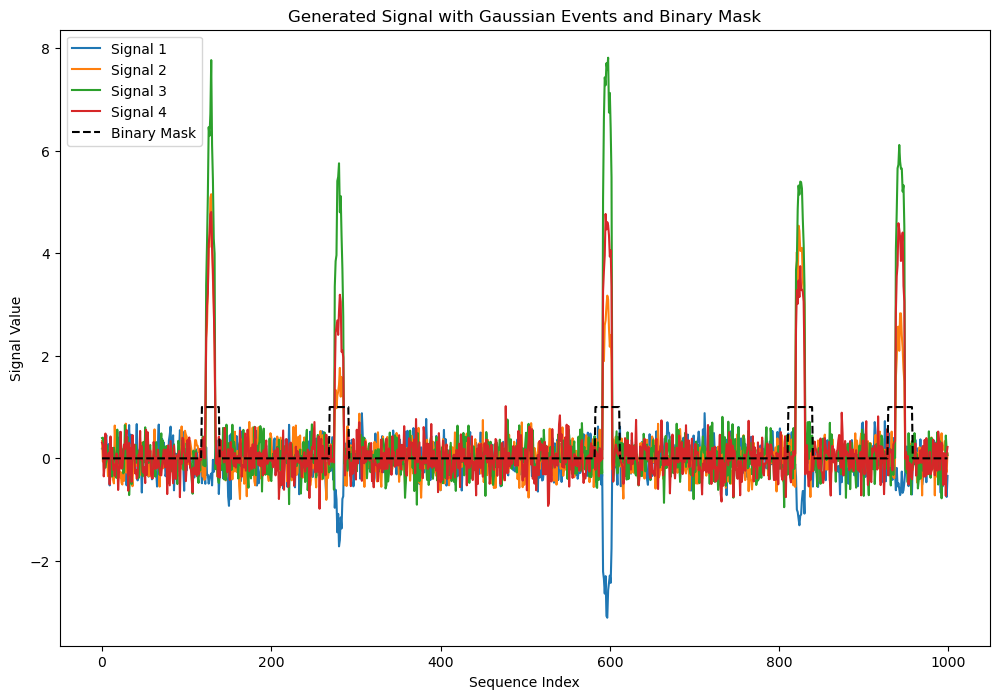

In [7]:
# Plot each of the 8 signal components and overlay the binary mask
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
for i in range(input_size):
    plt.plot(sequence[:, i], label=f"Signal {i+1}")

mask = create_binary_mask(seq_len, event_positions, event_widths)
plt.plot(mask, label="Binary Mask", linestyle="--", color="black")

plt.title("Generated Signal with Gaussian Events and Binary Mask")
plt.xlabel("Sequence Index")
plt.ylabel("Signal Value")
plt.legend()
plt.show()

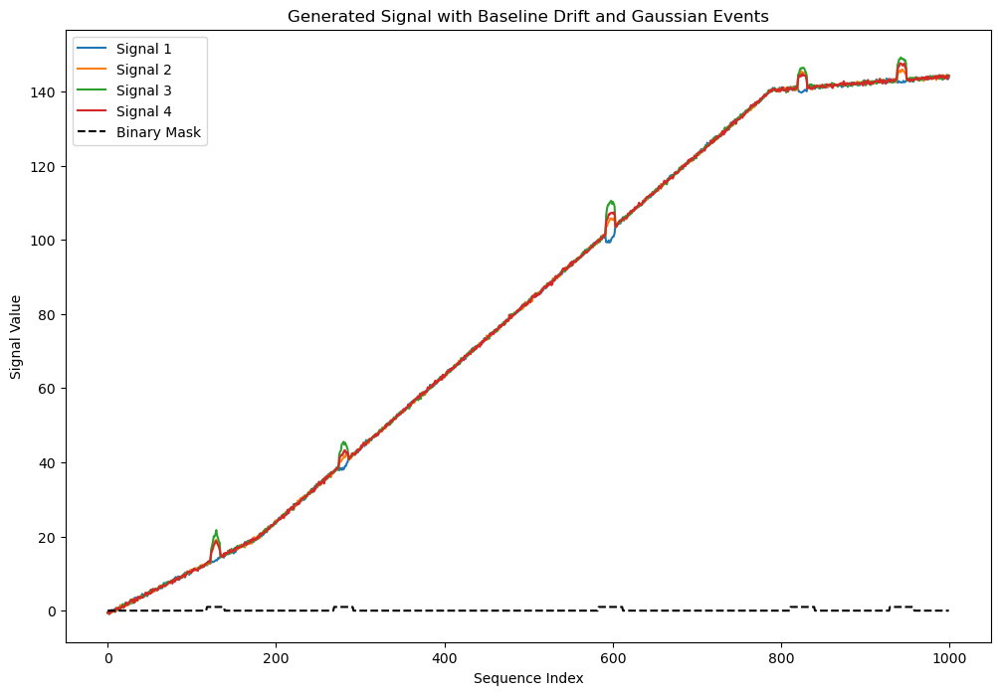

In [8]:
# Now plot the same signal with baseline drift
plt.figure(figsize=(12, 8))
for i in range(input_size):
    plt.plot(sequence_with_drift[:, i], label=f"Signal {i+1}")

plt.plot(mask, label="Binary Mask", linestyle="--", color="black")

plt.title("Generated Signal with Baseline Drift and Gaussian Events")
plt.xlabel("Sequence Index")
plt.ylabel("Signal Value")
plt.legend()
plt.show()

## Generate a large synthetic dataset and train the detection RNN

In [9]:
import os
import pandas as pd

# Use the functions defined above to generate a large dataset
n_samples = 100
seq_len = 1000
n_events = 5
impact_range = 15
noise_intensity = 0.3
do_add_baseline_drift = False

# Load the mean amplitude data (generated later in this notebook)
load_path = os.path.join("data", "labeled_segmentation_data", "mean_max_peak_amplitudes.csv")
mean_amplitude_df = pd.read_csv(load_path, index_col=0)

# Generate event properties for all samples
event_positions = []
event_amplitudes = []
event_widths = []
columns_to_use = mean_amplitude_df.columns[:8].tolist() #+ mean_amplitude_df.columns[6:].tolist()
for col in columns_to_use:
    event_amplitude_means = mean_amplitude_df[col].values * 2/3
    for _ in range(n_samples//len(columns_to_use)):
        pos, amp, width = generate_event_properties(n_events, seq_len, event_amplitude_means, input_size=4)
        event_positions.append(pos)
        event_amplitudes.append(amp)
        event_widths.append(width)

# Make n_samples be the final length
n_samples = len(event_positions)

# Generate the signals and masks for all samples
signals = []
masks = []
for pos, amp, width in zip(event_positions, event_amplitudes, event_widths):
    sequence = create_signal(seq_len, pos, amp, width, impact_range, noise_intensity, input_size=4)
    if do_add_baseline_drift:
        sequence = add_baseline_drift(sequence, num_pieces=3, max_slope=0.1)
    signals.append(sequence)
    masks.append(create_binary_mask(seq_len, pos, width))

# Convert the lists to numpy arrays
signals = np.array(signals)
masks = np.array(masks)

# Convert the signals and masks to PyTorch tensors
signals_tensor = torch.tensor(signals, dtype=torch.float32).to(device)
masks_tensor = torch.tensor(masks, dtype=torch.float32).to(device)

# Print the shapes of the tensors
print("Signals tensor shape:", signals_tensor.shape)
print("Masks tensor shape:", masks_tensor.shape)

# Create a DataLoader to load the data in batches
from torch.utils.data import TensorDataset, DataLoader

# Define the batch size
batch_size = 32

# Split the data into training and validation sets
n_train = int(0.8 * n_samples)
n_val = n_samples - n_train
# Shuffle the data
indices = torch.randperm(n_samples)
signals_tensor = signals_tensor[indices]
masks_tensor = masks_tensor[indices]
train_dataset = TensorDataset(signals_tensor[:n_train], masks_tensor[:n_train])
val_dataset = TensorDataset(signals_tensor[n_train:], masks_tensor[n_train:])

# # Create a TensorDataset
# train_dataset = TensorDataset(signals_tensor, masks_tensor)

# Create a DataLoader
train_data_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_data_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# Print lengths of train and validation sets
print("Number of training samples:", len(train_data_loader.dataset))
print("Number of validation samples:", len(val_data_loader.dataset))

# Define the model, loss function, and optimizer
segmentation_model = BinarySegmentationRNN(input_size=4).to(device)
criterion = nn.BCELoss()
optimizer = torch.optim.Adam(segmentation_model.parameters(), lr=0.001)


Signals tensor shape: torch.Size([96, 1000, 4])
Masks tensor shape: torch.Size([96, 1000])
Number of training samples: 76
Number of validation samples: 20


In [10]:
# Train the model
num_epochs = 10
for epoch in range(num_epochs):
    # Training loop
    train_loss = 0.0
    for signals_batch, masks_batch in train_data_loader:
        # Zero the gradients
        optimizer.zero_grad()
        
        # Forward pass
        output = segmentation_model(signals_batch)
        
        # Calculate the loss
        loss = criterion(output, masks_batch)
        
        # Backward pass
        loss.backward()
        
        # Update the weights
        optimizer.step()
        
        train_loss += loss.item() * signals_batch.size(0)
    
    # Calculate average training loss
    train_loss /= len(train_data_loader.dataset)
    
    # Validation loop
    segmentation_model.eval()  # Set the model to evaluation mode
    validation_loss = 0.0
    with torch.no_grad():
        for signals_batch, masks_batch in val_data_loader:
            # Forward pass
            output = segmentation_model(signals_batch)
            
            # Calculate the loss
            val_loss = criterion(output, masks_batch)
            
            # Accumulate the validation loss
            validation_loss += val_loss.item() * signals_batch.size(0)
    
    # Calculate average validation loss
    validation_loss /= len(val_data_loader.dataset)
    
    segmentation_model.train()  # Set the model back to training mode
    
    print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {validation_loss:.4f}")

Epoch 1/10, Train Loss: 0.6629, Validation Loss: 0.5632
Epoch 2/10, Train Loss: 0.4970, Validation Loss: 0.3126
Epoch 3/10, Train Loss: 0.4085, Validation Loss: 0.2950
Epoch 4/10, Train Loss: 0.3090, Validation Loss: 0.3020
Epoch 5/10, Train Loss: 0.2831, Validation Loss: 0.2740
Epoch 6/10, Train Loss: 0.2680, Validation Loss: 0.2513
Epoch 7/10, Train Loss: 0.2364, Validation Loss: 0.2156
Epoch 8/10, Train Loss: 0.2049, Validation Loss: 0.2020
Epoch 9/10, Train Loss: 0.1882, Validation Loss: 0.1805
Epoch 10/10, Train Loss: 0.1686, Validation Loss: 0.1751


In [11]:
# Test the trained model on a new piece of synthetic data

import plotly.graph_objects as go

# Generate a new signal and mask
event_positions, event_amplitudes, event_widths = generate_event_properties(50, seq_len*5, event_amplitude_means, input_size=4)
sequence = create_signal(seq_len*5, event_positions, event_amplitudes, event_widths, impact_range, noise_intensity=noise_intensity, input_size=4)
if do_add_baseline_drift:
    sequence = add_baseline_drift(sequence, num_pieces=3, max_slope=0.001, add_bias=False)
mask = create_binary_mask(seq_len*5, event_positions, event_widths)

# Convert the sequence to a PyTorch tensor
sequence_tensor = torch.tensor(sequence, dtype=torch.float32).unsqueeze(0).to(device)

# Get the model prediction
with torch.no_grad():
    segmentation_model.eval()
    predicted_mask = segmentation_model(sequence_tensor).squeeze().cpu().numpy()

# Create a Plotly figure
fig = go.Figure()

# Add traces for each dimension of the signal
for i in range(input_size):
    fig.add_trace(go.Scatter(y=sequence[:, i], mode='lines', name=f"Signal {i+1}"))

# Add traces for the true and predicted mask
fig.add_trace(go.Scatter(y=mask, mode='lines', name="True Mask", line=dict(color='black', dash='dash', width=1)))
fig.add_trace(go.Scatter(y=predicted_mask, mode='lines', name="Predicted Mask", line=dict(color='red', dash='dot', width=3)))

# Set plot layout
fig.update_layout(
    title="Generated Signal with True and Predicted Binary Mask",
    xaxis_title="Sequence Index",
    yaxis_title="Signal Value",
    legend_title="Legend"
)

# Show the plot
fig.show()


Intersection over Union (IoU): 0.8608757062146892
Dice Coefficient: 0.9015267750983504
Precision: 0.8207089209471332
Recall: 1.0
F1 Score: 0.9015267750983504
Matthews Correlation Coefficient (MCC): nan


/local_scratch/slurm.463572/ipykernel_3512623/4105734358.py:95: RuntimeWarning:

invalid value encountered in scalar divide



Area Under the ROC Curve (ROC AUC): 0.9954295445285852


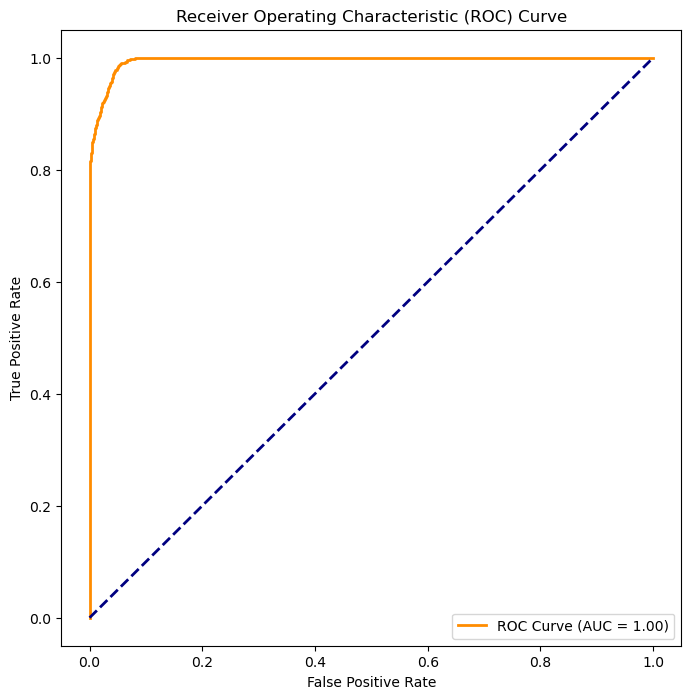

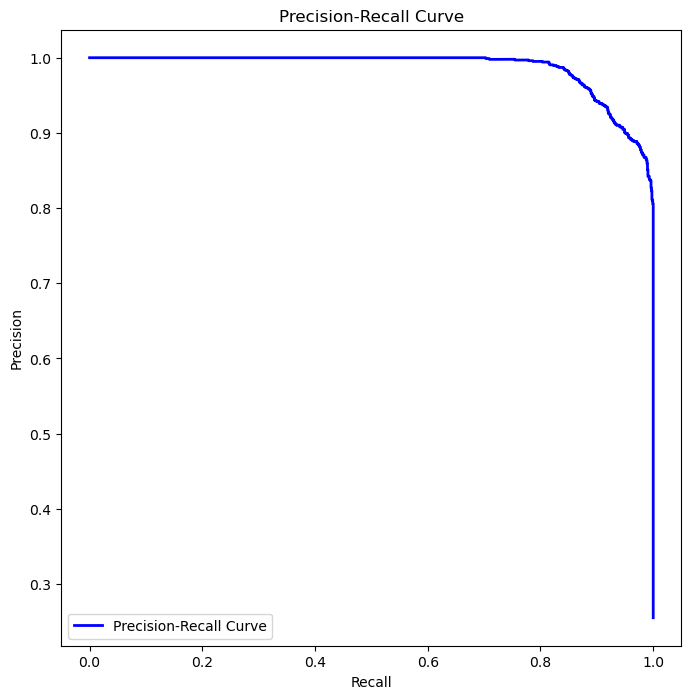

Average Precision (AP): 0.9871976341432


In [12]:
# Define a function to calculate the Intersection over Union (IoU) metric
def calculate_iou(y_true, y_pred, thresh=0.5):
    """
    Calculate the Intersection over Union (IoU) metric for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    float: The IoU score between the two masks.
    """
    y_pred = y_pred > thresh
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou = np.sum(intersection) / np.sum(union)
    return iou

# Calculate the IoU between the true mask and the predicted mask
iou = calculate_iou(mask, predicted_mask)
print("Intersection over Union (IoU):", iou)

# Define a function to calculate the Dice coefficient
def calculate_dice_coefficient(y_true, y_pred):
    """
    Calculate the Dice coefficient for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    float: The Dice coefficient between the two masks.
    """
    intersection = np.logical_and(y_true, y_pred)
    dice_coefficient = 2. * np.sum(intersection) / (np.sum(y_true) + np.sum(y_pred))
    return dice_coefficient

# Calculate the Dice coefficient between the true mask and the predicted mask
dice_coefficient = calculate_dice_coefficient(mask, predicted_mask)
print("Dice Coefficient:", dice_coefficient)

# Define a function to calculate the Precision, Recall, and F1 Score
def calculate_precision_recall_f1(y_true, y_pred):
    """
    Calculate the Precision, Recall, and F1 Score for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    tuple: A tuple containing:
        - precision (float): The Precision score.
        - recall (float): The Recall score.
        - f1_score (float): The F1 Score.
    """
    intersection = np.logical_and(y_true, y_pred)
    true_positive = np.sum(intersection)
    false_positive = np.sum(y_pred) - true_positive
    false_negative = np.sum(y_true) - true_positive

    precision = true_positive / (true_positive + false_positive)
    recall = true_positive / (true_positive + false_negative)
    f1_score = 2 * (precision * recall) / (precision + recall)

    return precision, recall, f1_score

# Calculate the Precision, Recall, and F1 Score between the true mask and the predicted mask
precision, recall, f1_score = calculate_precision_recall_f1(mask, predicted_mask)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1_score)

# Define a function to calculate the Matthews Correlation Coefficient (MCC)
def calculate_mcc(y_true, y_pred):
    """
    Calculate the Matthews Correlation Coefficient (MCC) for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    float: The Matthews Correlation Coefficient (MCC) between the two masks.
    """
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)

    tp = np.sum(intersection)
    tn = np.sum(np.logical_not(union))
    fp = np.sum(np.logical_and(np.logical_not(y_true), y_pred))
    fn = np.sum(np.logical_and(y_true, np.logical_not(y_pred)))

    mcc = (tp * tn - fp * fn) / np.sqrt((tp + fp) * (tp + fn) * (tn + fp) * (tn + fn))
    return mcc

# Calculate the Matthews Correlation Coefficient (MCC) between the true mask and the predicted mask
mcc = calculate_mcc(mask, predicted_mask)
print("Matthews Correlation Coefficient (MCC):", mcc)

# Define a function to calculate the Receiver Operating Characteristic (ROC) curve
from sklearn.metrics import roc_curve, auc

def calculate_roc_curve(y_true, y_pred):
    """
    Calculate the Receiver Operating Characteristic (ROC) curve for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    tuple: A tuple containing:
        - fpr (numpy.ndarray): An array of false positive rates.
        - tpr (numpy.ndarray): An array of true positive rates.
        - roc_auc (float): The Area Under the ROC Curve (ROC AUC).
    """
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)
    return fpr, tpr, roc_auc

# Calculate the Receiver Operating Characteristic (ROC) curve between the true mask and the predicted mask
fpr, tpr, roc_auc = calculate_roc_curve(mask, predicted_mask)
print("Area Under the ROC Curve (ROC AUC):", roc_auc)

# Plot the Receiver Operating Characteristic (ROC) curve
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f"ROC Curve (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

# Define a function to calculate the Precision-Recall curve
from sklearn.metrics import precision_recall_curve

def calculate_precision_recall_curve(y_true, y_pred):
    """
    Calculate the Precision-Recall curve for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    tuple: A tuple containing:
        - precision (numpy.ndarray): An array of precision values.
        - recall (numpy.ndarray): An array of recall values.
    """
    precision, recall, _ = precision_recall_curve(y_true, y_pred)
    return precision, recall

# Calculate the Precision-Recall curve between the true mask and the predicted mask
precision, recall = calculate_precision_recall_curve(mask, predicted_mask)

# Plot the Precision-Recall curve
plt.figure(figsize=(8, 8))
plt.plot(recall, precision, color='blue', lw=2, label='Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.show()

# Define a function to calculate the Average Precision (AP) score
from sklearn.metrics import average_precision_score

def calculate_average_precision(y_true, y_pred):
    """
    Calculate the Average Precision (AP) score for binary masks.

    Parameters:
    y_true (numpy.ndarray): The ground truth binary mask.
    y_pred (numpy.ndarray): The predicted binary mask.

    Returns:
    float: The Average Precision (AP) score.
    """
    ap = average_precision_score(y_true, y_pred)
    return ap

# Calculate the Average Precision (AP) score between the true mask and the predicted mask
ap = calculate_average_precision(mask, predicted_mask)
print("Average Precision (AP):", ap)



## Evaluate segmentation model on labeled data

In [13]:
import os
import pandas as pd

# Select the dataset to use
set = '3'

# Load the signal data and put it in a numpy array of shape (L, 8) where L is the length of the sequence
data_dir = os.path.join('/', 'home', 'cehrett', 'Projects', 'Microwave', 'data', 'labeled_segmentation_data')
signal_data_loc = os.path.join(data_dir, f'trended_and_detrended_signals_with_sigma_5_and_25_set{set}.csv')

def load_signal_data(signal_data_loc, convert_to_numpy=True):
    signal_df = pd.read_csv(signal_data_loc)

    # Get a df that just has the signal timestamps and detrended values for each of the two signals
    ## First, narrow to just the columns t1 and t2 and all cols starting with 'Detrended1'
    signal_cols = signal_df.columns[signal_df.columns.str.contains('Detrended1')]
    signal1_cols = signal_cols[:4].tolist()
    signal2_cols = signal_cols[4:].tolist()
    # Now get signal1_df and signal2_df
    signal1_df = signal_df[['t1'] + signal1_cols].copy()
    signal2_df = signal_df[['t2'] + signal2_cols].copy()

    # t1 and t2 are timestamps. Rename to 'timestamp'
    signal1_df.rename(columns={'t1':'timestamp'}, inplace=True)
    signal2_df.rename(columns={'t2':'timestamp'}, inplace=True)

    # Set the timestamp as the index
    signal1_df.set_index('timestamp', inplace=True)
    signal2_df.set_index('timestamp', inplace=True)

    # Drop all rows of signal1_df and signal2_df that have indices higher than the min of the max index of the two dfs
    min_max_index = min(signal1_df.index.max(), signal2_df.index.max())
    signal1_df = signal1_df[signal1_df.index <= min_max_index]
    signal2_df = signal2_df[signal2_df.index <= min_max_index]

    # Merge the two dataframes as an outer join
    signal_df = pd.merge(signal1_df, signal2_df, on='timestamp', how='outer')

    # Linearly interpolate the missing values
    signal_df.interpolate(method='linear', inplace=True)

    if convert_to_numpy:
        # Convert to numpy array
        signal_data = signal_df.to_numpy()
    else:  
        signal_data = signal_df
        
    # Also get two 4-dimensional versions
    if convert_to_numpy:
        signal1_data = signal1_df.to_numpy()
        signal2_data = signal2_df.to_numpy()
    else:
        signal1_data = signal1_df
        signal2_data = signal2_df
    # And normalize
    signal1_data = (signal1_data - signal1_data.mean(axis=0)) / signal1_data.std(axis=0)
    signal2_data = (signal2_data - signal2_data.mean(axis=0)) / signal2_data.std(axis=0)

    return signal_data, signal1_data, signal2_data

signal_data, signal1_data, signal2_data = load_signal_data(signal_data_loc)

In [14]:
# Plot the signal data
import plotly.express as px

# Create an interactive plot using Plotly Express
fig = px.line(signal_data)

# Show the plot
fig.show()

In [15]:
pd.set_option('future.no_silent_downcasting', True)

# Now load the mask as a 1D numpy array of length len(signal_data)
mask_data_loc = os.path.join(data_dir, f'segmentation_mask_set{set} - segmentation_mask_set{set}.csv')

def load_mask_data(mask_data_loc):
    mask_df = pd.read_csv(mask_data_loc)

    # Get a df that just has the signal timestamps and segmentation values for each of the two signals
    mask1_cols = mask_df.columns[mask_df.columns.str.contains('f1')].tolist()
    mask2_cols = mask_df.columns[mask_df.columns.str.contains('f2')].tolist()
    # Now get mask1_df and mask2_df
    mask1_df = mask_df[['t1'] + mask1_cols].copy()
    mask2_df = mask_df[['t2'] + mask2_cols].copy()

    # t1 and t2 are timestamps. Rename to 'timestamp'
    mask1_df.rename(columns={'t1':'timestamp'}, inplace=True)
    mask2_df.rename(columns={'t2':'timestamp'}, inplace=True)

    # Set the timestamp as the index
    mask1_df.set_index('timestamp', inplace=True)
    mask2_df.set_index('timestamp', inplace=True)

    # Drop all rows of mask1_df and mask2_df that have indices higher than the min of the max index of the two dfs
    min_max_index = min(mask1_df.index.max(), mask2_df.index.max())
    mask1_df = mask1_df[mask1_df.index <= min_max_index]
    mask2_df = mask2_df[mask2_df.index <= min_max_index]

    # Convert all values to boolean
    mask1_df = mask1_df.astype(bool)
    mask2_df = mask2_df.astype(bool)

    # Make a new col in each df which is the disjunction of all the other cols
    mask1_df['mask1'] = mask1_df.any(axis=1)
    mask2_df['mask2'] = mask2_df.any(axis=1)

    # Drop all the other cols
    mask1_df.drop(columns=mask1_cols, inplace=True)
    mask2_df.drop(columns=mask2_cols, inplace=True)

    # Merge the two dataframes as an outer join
    mask_df = pd.merge(mask1_df, mask2_df, on='timestamp', how='outer')

    # Fill the missing values by forward filling
    mask_df.ffill(inplace=True)

    # Replace the two cols with a single col, mask, which is the disjunction of mask1 and mask2
    mask_df['mask'] = mask_df['mask1'] | mask_df['mask2']
    mask_df.drop(columns=['mask1', 'mask2'], inplace=True)

    # Convert to numpy array
    mask_data = mask_df['mask'].to_numpy()

    # Also get two 4-dimensional versions
    mask1_df.rename(columns={'mask1':'mask'}, inplace=True)
    mask2_df.rename(columns={'mask2':'mask'}, inplace=True)
    mask1_data = mask1_df['mask'].to_numpy()
    mask2_data = mask2_df['mask'].to_numpy()

    return mask_data, mask1_data, mask2_data

mask_data, mask1_data, mask2_data = load_mask_data(mask_data_loc)


In [16]:
# Evaluate the trained model on the prepared real signal and mask data

for set in '1356':
    # Load the signal data and put it in a numpy array of shape (L, 8) where L is the length of the sequence
    data_dir = os.path.join('/', 'home', 'cehrett', 'Projects', 'Microwave', 'data', 'labeled_segmentation_data')
    signal_data_loc = os.path.join(data_dir, f'trended_and_detrended_signals_with_sigma_5_and_25_set{set}.csv')

    signal_data, signal1_data, signal2_data = load_signal_data(signal_data_loc)

    # Now load the mask as a 1D numpy array of length len(signal_data)
    mask_data_loc = os.path.join(data_dir, f'segmentation_mask_set{set} - segmentation_mask_set{set}.csv')

    mask_data, mask1_data, mask2_data = load_mask_data(mask_data_loc)

    for data, mask, freq in zip([signal1_data, signal2_data], [mask1_data, mask2_data], [1,2]):

        # Convert the sequence to a PyTorch tensor
        sequence_tensor = torch.tensor(data, dtype=torch.float32).unsqueeze(0).to(device)

        # Get the model prediction
        with torch.no_grad():
            segmentation_model.eval()
            predicted_mask = segmentation_model(sequence_tensor).squeeze().cpu().numpy()

        # Create a Plotly figure
        fig = go.Figure()

        # Add traces for each dimension of the signal
        # for i in range(input_size):
        #     fig.add_trace(go.Scatter(y=data[:, i], mode='lines', name=f"Signal {i+1}"))

        # Add traces for the true and predicted mask. 
        fig.add_trace(go.Scatter(y=mask.astype(float) , mode='lines', name="True Mask", line=dict(color='black', dash='dash', width=1)))
        fig.add_trace(go.Scatter(y=predicted_mask, mode='lines', name="Predicted Mask", line=dict(color='red', dash='dot', width=3)))

        # Set plot layout
        fig.update_layout(
            title=f"Labeled Signal Set {set}, Freq. {freq} with True and Predicted Binary Mask",
            xaxis_title="Sequence Index",
            yaxis_title="Signal Value",
            legend_title="Legend",
            height=200,  # Adjust the height of the plot here
             margin=dict(l=10, r=10, t=30, b=5)  # Adjust the margin values to reduce whitespace  # Adjust the height of the plot here
        )

        # Show the plot
        fig.show()

In [17]:
# Save the segmentation model
save_path = os.path.join('models', 'binary_segmentation_rnn.pth')
torch.save(segmentation_model.state_dict(), save_path)

# Load the segmentation model
segmentation_model = BinarySegmentationRNN(input_size=4).to(device)
segmentation_model.load_state_dict(torch.load(save_path))
segmentation_model.eval()

BinarySegmentationRNN(
  (bi_lstm): LSTM(4, 512, batch_first=True, bidirectional=True)
  (fc): Linear(in_features=1024, out_features=1, bias=True)
  (sigmoid): Sigmoid()
)

## Get mean amplitudes of peaks in each signal component of each frequency of each dataset (for better synthetic data)

In [ ]:
# Define a function which returns the maximum magnitude value of each signal component for each contiguous segment where the mask is 1
def get_max_magnitude_values(signal_data, mask_data):
    """
    Get the maximum magnitude values of each signal component for each contiguous segment where the mask is 1.

    Parameters:
    signal_data (numpy.ndarray): The signal data of shape (L, 8) where L is the length of the sequence.
    mask_data (numpy.ndarray): The mask data of shape (L,) where L is the length of the sequence.

    Returns:
    list: A list of dictionaries where each dictionary contains the maximum magnitude values of each signal component
          for a contiguous segment where the mask is 1.
    """
    # Initialize the list of dictionaries
    max_magnitude_values = []

    # Find the indices where the mask transitions from 0 to 1
    start_indices = np.where((mask_data[:-1] == 0) & (mask_data[1:] == 1))[0]
    # Find the indices where the mask transitions from 1 to 0
    end_indices = np.where((mask_data[:-1] == 1) & (mask_data[1:] == 0))[0]

    # If the mask starts with a 1, add a start index at the beginning
    if mask_data[0] == 1:
        start_indices = np.insert(start_indices, 0, 0)
    # If the mask ends with a 1, add an end index at the end
    if mask_data[-1] == 1:
        end_indices = np.append(end_indices, len(mask_data) - 1)

    # Iterate through the start and end indices
    for start, end in zip(start_indices, end_indices):
        # Get the segment
        segment = signal_data[start:end+1]
        # Loop over the four signal components
        for i in range(4):
            # Get the segment of this component
            component = segment[:, i]
            # Get absolute value version
            abs_component = np.abs(component)
            # Get the index of the maximum value
            max_index = np.argmax(abs_component)
            # Get the original value at this index
            max_value = component[max_index]
            # Add to the list
            max_magnitude_values.append({f"Signal {i+1}": max_value})

    return max_magnitude_values

In [ ]:
df = pd.DataFrame()

for set in '1356':

    # Load the signal data and put it in a numpy array of shape (L, 8) where L is the length of the sequence
    data_dir = os.path.join('/', 'home', 'cehrett', 'Projects', 'Microwave', 'data', 'labeled_segmentation_data')
    signal_data_loc = os.path.join(data_dir, f'trended_and_detrended_signals_with_sigma_5_and_25_set{set}.csv')
    signal_data, signal1_data, signal2_data = load_signal_data(signal_data_loc)

    # Now load the mask as a 1D numpy array of length len(signal_data)
    mask_data_loc = os.path.join(data_dir, f'segmentation_mask_set{set} - segmentation_mask_set{set}.csv')
    mask_data, mask1_data, mask2_data = load_mask_data(mask_data_loc)

    # Combine the two signals and masks for each of the two freqs
    df1 = pd.DataFrame(signal1_data, columns=[f'signal_{i+1}' for i in range(4)])
    df1['mask'] = mask1_data
    df2 = pd.DataFrame(signal2_data, columns=[f'signal_{i+1}' for i in range(4)])
    df2['mask'] = mask2_data

    # Get the maximum magnitude values for each contiguous segment where the mask is 1
    max_magnitude_values1 = get_max_magnitude_values(signal1_data, mask1_data)
    max_magnitude_values2 = get_max_magnitude_values(signal2_data, mask2_data)
    max_df1 = pd.DataFrame(max_magnitude_values1).mean()
    max_df1.name = f'set{set}_freq1'
    max_df2 = pd.DataFrame(max_magnitude_values2).mean()
    max_df2.name = f'set{set}_freq2'

    # Append the data to the main dataframe
    df = pd.concat([df, max_df1, max_df2], ignore_index=False, axis=1)

# Display the dataframe
print(df)

# Save the dataframe to a CSV file
saveto_path = os.path.join('data', 'labeled_segmentation_data', 'mean_max_peak_amplitudes.csv')
df.to_csv(saveto_path)

## Time-align two frequencies using the output of the segmentation model

In [ ]:
import pandas as pd
import numpy as np

def find_time_bias(freq1: pd.Series, freq2: pd.Series, verbose=False) -> float:
    # Ensure the indices are floats
    freq1.index = freq1.index.astype(float)
    freq2.index = freq2.index.astype(float)

    # Merge the two series to ensure they have the same index
    freq1_aligned = pd.merge(pd.DataFrame(index=freq2.index), freq1, left_index=True, right_index=True, how='outer')
    freq2_aligned = pd.merge(pd.DataFrame(index=freq1.index), freq2, left_index=True, right_index=True, how='outer')

    # Interpolate missing values
    freq1_interpolated = freq1_aligned.interpolate()
    freq2_interpolated = freq2_aligned.interpolate()

    # Drop any remaining NaN values
    freq1_interpolated = freq1_interpolated.dropna()
    freq2_interpolated = freq2_interpolated.dropna()

    # Align the two series on the same time range
    start_time = max(freq1_interpolated.index.min(), freq2_interpolated.index.min())
    end_time = min(freq1_interpolated.index.max(), freq2_interpolated.index.max())

    freq1_interpolated = freq1_interpolated.loc[start_time:end_time]
    freq2_interpolated = freq2_interpolated.loc[start_time:end_time]

    # Compute cross-correlation to find the optimal lag
    freq1_normd = freq1_interpolated - freq1_interpolated.mean()
    freq2_normd = freq2_interpolated - freq2_interpolated.mean()
    freq1_normd = freq1_normd.squeeze()
    freq2_normd = freq2_normd.squeeze()

    correlation = np.correlate(freq1_normd, freq2_normd, mode='full')
    lag = correlation.argmax() - (len(freq1_interpolated) - 1)

    # Convert lag into time bias (in seconds)
    ## First, find the average time difference between two consecutive indices in freq1_interpolated
    time_diff = np.mean(np.diff(freq1_interpolated.index))
    time_bias = lag * time_diff

    time_bias

    return time_bias


In [ ]:
def get_predicted_mask(signal_data, model):
    # Convert the sequence to a PyTorch tensor
    sequence_tensor = torch.tensor(signal_data.to_numpy(), dtype=torch.float32).unsqueeze(0).to(device)

    # Get the model prediction
    with torch.no_grad():
        model.eval()
        predicted_mask = model(sequence_tensor).squeeze().cpu().numpy()

    return predicted_mask

In [ ]:
def align_freqs(signal1_data, signal2_data, model, start_time, end_time, verbose=False):
    # Add a predicted segmentation mask to the freq dfs
    predicted_mask1 = get_predicted_mask(signal1_data, model)
    predicted_mask2 = get_predicted_mask(signal2_data, model)

    # Make a series with index equal to each timestamp in the signal data and values equal to the predicted mask
    signal1_data['mask'] = predicted_mask1
    signal2_data['mask'] = predicted_mask2
    
    # Find the time bias to align the two signals
    bias = find_time_bias(signal1_data['mask'].loc[start_time:end_time], signal2_data['mask'].loc[start_time:end_time], verbose=verbose)

    # Correct the time index of signal2_data by adding time_bias to each index value of signal2_data
    signal2_data_corrected = signal2_data.copy()
    signal2_data_corrected.index = signal2_data_corrected.index + bias

    return signal1_data, signal2_data_corrected, bias

In [ ]:
def align_freqs_and_get_predicted_mask(signal1_data, 
                                       signal2_data, 
                                       segmentation_model, 
                                       start_time, 
                                       end_time, 
                                       thresh=0.5,
                                       verbose=False):
    """
This function uses the `align_freqs` function to align the two signals
in time, and also uses the segmentation_model to get a predicted mask for
each of the two signal frequencies. Those two predicted masks are then combined,
as follows. The two masks are first averaged (for each time point), and then
are thresholded at `thresh` to get a final predicted mask. This final predicted mask
is binary.
    """
    ...

    return signal1_data, signal2_data_aligned, predicted_mask


In [ ]:
# Try out the pipeline and plot results
# Select the dataset to use
set = '6'

# Set start and end times
start_time = 0.1
end_time = 10

# Load the signal data 
data_dir = os.path.join('/', 'home', 'cehrett', 'Projects', 'Microwave', 'data', 'labeled_segmentation_data')
signal_data_loc = os.path.join(data_dir, f'trended_and_detrended_signals_with_sigma_5_and_25_set{set}.csv')

signal_data, signal1_data, signal2_data = load_signal_data(signal_data_loc, convert_to_numpy=False)

# Plot the original data predicted masks
import plotly.graph_objects as go

# Create a Plotly figure
fig = go.Figure()

# Add traces for each of freq1 and freq2
fig.add_trace(go.Scatter(x=signal1_data.index, y=get_predicted_mask(signal1_data, segmentation_model).squeeze(), mode='lines', name="Signal 1"))
fig.add_trace(go.Scatter(x=signal2_data.index, y=get_predicted_mask(signal2_data, segmentation_model).squeeze(), mode='lines', name="Signal 2"))

# Set plot layout
fig.update_layout(
    title="Predicted Masks Before Alignment",
    xaxis_title="Time",
    yaxis_title="Mask Value",
    legend_title="Legend"
)

# Show the plot
fig.show()

# Change the index of signal2_data, to be aligned with signal1_data
signal1_data, signal2_data, time_bias = align_freqs(signal1_data, signal2_data, segmentation_model, start_time, end_time)

# Plot the aligned signals
# Create a Plotly figure
fig = go.Figure()

# Add traces for each of freq1 and freq2
fig.add_trace(go.Scatter(x=signal1_data.index, y=signal1_data['mask'].squeeze(), mode='lines', name="Signal 1"))
fig.add_trace(go.Scatter(x=signal2_data.index, y=signal2_data['mask'].squeeze(), mode='lines', name="Signal 2"))

# Set plot layout
fig.update_layout(
    title="Aligned Signals",
    xaxis_title="Time",
    yaxis_title="Signal Value",
    legend_title="Legend"
)

# Print the time bias
print(f"Aligned the two frequencies over the time range [{start_time}, {end_time}]")
print(f"Time bias: {time_bias:.3f} seconds")

# Show the plot
fig.show()


## Create classification CNN

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# set kernel size
ks = (5,5)

# set height
h = 4

# set length
L = 20

class ClassificationCNN(nn.Module):
    def __init__(self, input_length=L, num_classes=8):
        super(ClassificationCNN, self).__init__()
        self.conv1 = nn.Conv2d(in_channels=2, out_channels=20, kernel_size=ks, padding=2)
        self.bn1 = nn.BatchNorm2d(20)
        self.conv2 = nn.Conv2d(in_channels=20, out_channels=20, kernel_size=ks, padding=2)
        self.bn2 = nn.BatchNorm2d(20)
        self.conv3 = nn.Conv2d(in_channels=20, out_channels=20, kernel_size=ks, padding=2)
        self.bn3 = nn.BatchNorm2d(20)
        
        # The output size should remain h x L due to padding, and there are 20 channels
        # Calculate the flattened size
        self.fc_input_size = 20 * h * input_length  # 20 channels, height h maintained, length 106 maintained
        self.fc = nn.Linear(self.fc_input_size, num_classes)
    
    def forward(self, x):
        # Block 1
        x = self.conv1(x)
        x = self.bn1(x)
        x = F.relu(x)

        # Block 2
        x = self.conv2(x)
        x = self.bn2(x)
        x = F.relu(x)

        # Block 3
        x = self.conv3(x)
        x = self.bn3(x)
        x = F.relu(x)

        # Flatten before passing to the fully connected layer
        x = torch.flatten(x, 1)

        # Fully connected layer
        x = self.fc(x)

        # Softmax for classification
        output = F.softmax(x, dim=1)
        return output

# Example usage:
model = ClassificationCNN()
input_tensor = torch.randn(1, 2, h, L)  # Example input batch where N=1, C=2, H=h, W=L
output = model(input_tensor)
print(output.shape)  # Should be torch.Size([1, 8]) indicating the output class probabilities for 8 classes


### Generate synthetic data to try out classification CNN

In [ ]:
# Create 8 different 8-dimensional means to represent our 8 classes
# First, create 8x8 array of all ones, scale it down, and then add a small amount to the diagonal
class_means = np.ones((8, 8)) * 0.8
class_means += np.eye(8) * 0.2

# Exponentiate each element of each mean, as a temperature control for differences between the means
raiseto_power = 1
class_means = np.exp(np.log(class_means) * raiseto_power)
class_means

In [ ]:
# Create a dataset. For each class, generate a sequence of n_events events with the corresponding class mean,
# create signals from those events, and create a target vector of classification labels.
n_samples = 100
seq_len = 1000
n_events = 5
impact_range = 15
noise_intensity = 0.3

# Generate event properties for all samples
event_positions = []
event_amplitudes = []
event_widths = []
class_labels = []
binary_masks = []
# Loop through the classes in class_means
for class_idx, class_mean in enumerate(class_means):
    for _ in range(n_samples):
        pos, amp, width = generate_event_properties(n_events, seq_len, class_mean, input_size=8)
        event_positions.append(pos)
        event_amplitudes.append(amp)
        event_widths.append(width)
        class_labels.append(class_idx)
        binary_masks.append(create_binary_mask(seq_len, pos, width))

# Generate the signals for all samples
signals = []
for pos, amp, width in zip(event_positions, event_amplitudes, event_widths):
    signals.append(create_signal(seq_len, pos, amp, width, impact_range, noise_intensity=noise_intensity, input_size=8))

In [ ]:
# Check if signals has any nan values
nan_values = np.isnan(signals)
print("Number of NaN values in signals:", np.sum(nan_values))

# Check how many non-nan values are in signals
non_nan_values = np.sum(~nan_values)
print("Number of non-NaN values in signals:", non_nan_values)

In [ ]:
# Take a look at a signal from each class in 4x2 subplot grid
fig, axs = plt.subplots(4, 2, figsize=(16, 16))
for i in range(8):
    ax = axs[i // 2, i % 2]
    signal_idx = class_labels.index(i)
    signal = signals[signal_idx]   
    ax.plot(signal)
    ax.set_title(f"Example of Class {i}")
    # Overlay the binary mask for the events
    mask = binary_masks[signal_idx]
    ax.plot(mask, linestyle="--", color="black")

plt.tight_layout()
plt.show()

In [ ]:
# Define a function which can take in the signals, the labels, and the binary masks, and 
# output both a tensor of shape (N, 2, h, L) where N is the total number of events in all the signals
# and also a tensor of shape (N,) containing the class labels
def create_classification_dataset(signals, class_labels, binary_masks, L):
    """
    Create a classification dataset from the signals, class labels, and binary masks.

    Parameters:
    signals (list of numpy.ndarray): A list of signals, each of shape (seq_len, 8).
    class_labels (list of int): A list of class labels corresponding to each signal.
    binary_masks (list of numpy.ndarray): A list of binary masks for each signal.

    Returns:
    tuple: A tuple containing:
        - input_tensor (torch.Tensor): A tensor of shape (N, 2, h, L) where N is the total number of events
                                       in all the signals.
        - target_tensor (torch.Tensor): A tensor of shape (N,) containing the class labels.
    """
    input_tensor = []
    target_tensor = []

    for signal, label, mask in zip(signals, class_labels, binary_masks):
        # For each contiguous segment of 1s in the binary mask, find the corresponding segment in the signal
        # and take the first four and last four dims of the signal to form a 2-channel input
        mask_segments = []
        signal_segments = []
        labels = []
        for i in range(len(mask)):
            if mask[i] == 1:
                if i == 0 or mask[i-1] == 0:
                    mask_segments.append([i])
                else:
                    mask_segments[-1].append(i)
        # For each mask segment, extract the corresponding segment from the signal
        for segment in mask_segments:
            start, end = segment[0], segment[-1]
            end = min(end + 1, start + L)
            signal_segment = signal[start:end]
            labels.append(label)

            # Pad the signal segments to length L (with 0s), so that each segment has shape Lx8
            padding = np.zeros((L - len(signal_segment), 8))
            padded_segment = np.concatenate([signal_segment, padding], axis=0)
            signal_segments.append(padded_segment)
            

        # Split each signal segment into two 4-channel segments of length L
        input_segments = []
        for segment in signal_segments:
            input_segment = np.stack([segment[:,:4], segment[:,4:]])
            input_segments.append(input_segment)

        # Append the input segments and labels to the tensors
        input_tensor.extend(input_segments)
        target_tensor.extend(labels)

    # Convert the lists to PyTorch tensors
    input_tensor = torch.tensor(input_tensor, dtype=torch.float32)
    target_tensor = torch.tensor(target_tensor, dtype=torch.long)

    return input_tensor, target_tensor

In [ ]:
# Create the synthetic classification dataset
input_tensor, target_tensor = create_classification_dataset(signals, class_labels, binary_masks, L)

# Print the shapes of the tensors
print("Input tensor shape:", input_tensor.shape)
print("Target tensor shape:", target_tensor.shape)

# Create a DataLoader to load the data in batches
from torch.utils.data import TensorDataset, DataLoader

# Define the batch size
batch_size = 128

# Create a TensorDataset
dataset = TensorDataset(input_tensor, target_tensor)

# Create a DataLoader
data_loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Define the model, loss function, and optimizer
classification_model = ClassificationCNN(input_length=L, num_classes=8).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(classification_model.parameters(), lr=0.001)

# Train the model
num_epochs = 30
for epoch in range(num_epochs):
    for input_batch, target_batch in data_loader:
        # Zero the gradients
        optimizer.zero_grad()

        # Move the input and target batch to the device
        input_batch = input_batch.to(device)
        target_batch = target_batch.to(device)

        # Forward pass
        output = classification_model(input_batch)

        # Calculate the loss
        loss = criterion(output, target_batch)

        # Backward pass
        loss.backward()

        # Update the weights
        optimizer.step()

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.item():.4f}")



In [ ]:
# Define a function to calculate the accuracy of the model
def calculate_accuracy(y_true, y_pred):
    """
    Calculate the accuracy of the model.

    Parameters:
    y_true (numpy.ndarray): The ground truth labels.
    y_pred (numpy.ndarray): The predicted labels.

    Returns:
    float: The accuracy of the model.
    """
    correct = np.sum(y_true == y_pred)
    total = len(y_true)
    accuracy = correct / total
    return accuracy

# Get the model predictions
with torch.no_grad():
    classification_model.eval()
    predictions = []
    true_labels = []
    for input_batch, target_batch in data_loader:
        input_batch = input_batch.to(device)
        output = classification_model(input_batch)
        _, predicted = torch.max(output, 1)
        predictions.extend(predicted.cpu().numpy())
        true_labels.extend(target_batch.cpu().numpy())

# Calculate the accuracy of the model
accuracy = calculate_accuracy(np.array(true_labels), np.array(predictions))
print("Accuracy:", accuracy)

In [ ]:
#scr
pd.merge(signal1_data, signal2_data, on='timestamp', how='outer', suffixes=('_1', '_2')).interpolate(method='linear').dropna()

# Create a data ingestion pipeline which transforms data files into tensor datasets

In [ ]:
def convert_data_file_to_dataset(file_loc, segmentation_model, segmentation_threshold=0.5, device='cuda'):
    """
    Convert a data file to a dataset that can be used for classification.

    Parameters:
    file_loc (str): The location of the data file.
    segmentation_model (torch.nn.Module): The trained segmentation model.
    segmentation_threshold (float): The threshold for the segmentation model.
    device (str): The device to use for the tensors.

    Returns:
    tuple: A tuple containing:
        - input_tensor (torch.Tensor): A tensor of shape (N, 2, h, L) where N is the total number of events
                                       in all the signals.
        - target_tensor (torch.Tensor): A tensor of shape (N,) containing the class labels.
    """
    # Load the signal data
    signal_data, signal1_data, signal2_data = load_signal_data(file_loc, convert_to_numpy=False)

    # Align the two signals
    start_time = 0.1
    end_time = 10
    signal1_data, signal2_data, time_bias = align_freqs(signal1_data, signal2_data, segmentation_model, start_time, end_time)

    # Join the two signals into a single dataframe
    signal_data = pd.merge(signal1_data, signal2_data, on='timestamp', how='outer', suffixes=('_1', '_2'))

    # Linearly interpolate the missing values
    signal_data.interpolate(method='linear', inplace=True)

    # Drop any remaining NaN values
    signal_data.dropna(inplace=True)

    # Separate the 'mask_1' and 'mask_2' columns from the signal data, and drop them from the original df
    mask1_data = signal_data['mask_1']
    mask2_data = signal_data['mask_2']
    signal_data.drop(columns=['mask_1', 'mask_2'], inplace=True)

    # Threshold each of the two masks
    mask1_data = (mask1_data > segmentation_threshold)
    mask2_data = (mask2_data > segmentation_threshold)

    # Get a single mask which is the logical disjunction of the two mask series
    mask_data = mask1_data | mask2_data
    mask_data = mask_data.astype(int)

    # Create the classification dataset
    input_tensor, target_tensor = create_classification_dataset([signal_data.to_numpy()], [0], [mask_data.to_numpy()], L)

    return input_tensor, target_tensor

In [ ]:
# Make a dataset

# Select the dataset to use
set = '6'

# Load the signal data and put it in a numpy array of shape (L, 8) where L is the length of the sequence
data_dir = os.path.join('/', 'home', 'cehrett', 'Projects', 'Microwave', 'data', 'labeled_segmentation_data')
signal_data_loc = os.path.join(data_dir, f'trended_and_detrended_signals_with_sigma_5_and_25_set{set}.csv')

input_tensor, target_tensor = convert_data_file_to_dataset(signal_data_loc, segmentation_model)